# 🛠️ Exercise - Exploratory Data Analysis (EDA) | Example 02 Using FiftyOne Tool
- https://github.com/voxel51/fiftyone

[![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/MichaelAkridge-NOAA/ai4me-cookbook/blob/main/content/03_module/00_EDA_example_02.ipynb)
## Workshop Sample Dataset
- https://storage.googleapis.com/nmfs_odp_pifsc/PIFSC/ESD/ARP/pifsc-ai-data-repository/fish-detection/workshop/fish_dataset.zip



In [ ]:
# 📌 Step 1: Install Required Libraries (If Not Installed)
!pip install opencv-python numpy pandas matplotlib tqdm albumentations
# 📌 Install FiftyOne and Ultralytics YOLO
!pip install fiftyone ultralytics

In [2]:
# Import packages
import os
import requests
import zipfile
import glob
import fiftyone as fo
import fiftyone.types as fot
from ultralytics import YOLO
from tqdm import tqdm

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [3]:
# Setup Paths
# Google Cloud Storage URLs
dataset_url = "https://storage.googleapis.com/nmfs_odp_pifsc/PIFSC/ESD/ARP/pifsc-ai-data-repository/fish-detection/workshop/fish_dataset.zip"
model_url = "https://storage.googleapis.com/nmfs_odp_pifsc/PIFSC/ESD/ARP/pifsc-ai-data-repository/fish-detection/workshop/00_yolo11n_fish_2016_v1.pt"

# Local paths for dataset & model
dataset_zip_path = "/content/fish_dataset.zip"
dataset_extract_path = "/content/fish_dataset/"
model_path = "/content/00_yolo11n_fish_2016_v1.pt"

## Download Dataset & Model

In [4]:
def download_file(url, output_path):
    response = requests.get(url, stream=True)
    total_size = int(response.headers.get("content-length", 0))

    with open(output_path, "wb") as file, tqdm(
        desc=f"Downloading {os.path.basename(output_path)}",
        total=total_size,
        unit="B",
        unit_scale=True,
        unit_divisor=1024,
    ) as bar:
        for data in response.iter_content(chunk_size=1024):
            file.write(data)
            bar.update(len(data))

# Download dataset if it doesn't exist
if not os.path.exists(dataset_zip_path):
    download_file(dataset_url, dataset_zip_path)
else:
    print("✔ Dataset already downloaded.")

# Extract dataset
if not os.path.exists(dataset_extract_path):
    with zipfile.ZipFile(dataset_zip_path, "r") as zip_ref:
        zip_ref.extractall(dataset_extract_path)
    print(f"✔ Extracted dataset to {dataset_extract_path}")
else:
    print("✔ Dataset already extracted.")

# Download YOLO model if it doesn't exist
if not os.path.exists(model_path):
    download_file(model_url, model_path)
else:
    print("✔ YOLO model already downloaded.")


✔ Extracted dataset to /content/fish_dataset/


In [5]:
def load_yolov8_dataset(dataset_name="fish-detection", dataset_dir=dataset_extract_path):
    """
    Loads a YOLOv8 dataset into FiftyOne.
    """
    if dataset_name in fo.list_datasets():
        fo.delete_dataset(dataset_name)

    dataset = fo.Dataset.from_dir(
        dataset_type=fot.YOLOv5Dataset,
        dataset_dir=dataset_dir,
        name=dataset_name
    )

    return dataset

dataset = load_yolov8_dataset()
print(f"✅ FiftyOne dataset '{dataset.name}' loaded with {len(dataset)} samples.")


 100% |█████████████████| 196/196 [730.6ms elapsed, 0s remaining, 269.9 samples/s] 


INFO:eta.core.utils: 100% |█████████████████| 196/196 [730.6ms elapsed, 0s remaining, 269.9 samples/s] 


✅ FiftyOne dataset 'fish-detection' loaded with 196 samples.


In [6]:
def add_predictions(dataset, model_path, image_dir):
    """
    Runs YOLOv8 inference on images and adds predictions to FiftyOne.
    """
    model = YOLO(model_path)  # Load  model

    dataset_images = {os.path.basename(sample.filepath): sample.filepath for sample in dataset}
    image_paths = glob.glob(os.path.join(image_dir, "*.jpg")) + glob.glob(os.path.join(image_dir, "*.png"))

    for image_path in image_paths:
        filename = os.path.basename(image_path)

        if filename not in dataset_images:
            print(f"Skipping {filename}, not found in FiftyOne dataset")
            continue

        sample = dataset[dataset_images[filename]]

        # Run inference
        results = model(image_path)

        detections = []
        for result in results:
            for box in result.boxes.data:
                x1, y1, x2, y2, conf, class_id = box.tolist()

                # Convert to FiftyOne format
                detections.append(
                    fo.Detection(
                        label=str(int(class_id)),
                        bounding_box=[
                            x1 / result.orig_shape[1],
                            y1 / result.orig_shape[0],
                            (x2 - x1) / result.orig_shape[1],
                            (y2 - y1) / result.orig_shape[0],
                        ],
                        confidence=conf
                    )
                )

        # Add predictions to FiftyOne dataset
        sample["yolov8_predictions"] = fo.Detections(detections=detections)
        sample.save()

val_img_dir = os.path.join(dataset_extract_path, "images", "val")
add_predictions(dataset, model_path, val_img_dir)
print("✅ Model predictions added to FiftyOne dataset.")



image 1/1 /content/fish_dataset/images/val/20161014.193710.844.011223.jpg: 512x640 4 fishs, 351.1ms
Speed: 18.9ms preprocess, 351.1ms inference, 30.8ms postprocess per image at shape (1, 3, 512, 640)

image 1/1 /content/fish_dataset/images/val/20161014.193625.281.010676.jpg: 512x640 5 fishs, 184.1ms
Speed: 4.1ms preprocess, 184.1ms inference, 1.0ms postprocess per image at shape (1, 3, 512, 640)

image 1/1 /content/fish_dataset/images/val/20161014.193321.099.008465.jpg: 512x640 2 fishs, 176.3ms
Speed: 9.9ms preprocess, 176.3ms inference, 1.0ms postprocess per image at shape (1, 3, 512, 640)

image 1/1 /content/fish_dataset/images/val/20161014.193938.454.012995.jpg: 512x640 4 fishs, 163.6ms
Speed: 3.8ms preprocess, 163.6ms inference, 1.0ms postprocess per image at shape (1, 3, 512, 640)

image 1/1 /content/fish_dataset/images/val/20161014.193255.276.008155.jpg: 512x640 1 fish, 173.5ms
Speed: 3.9ms preprocess, 173.5ms inference, 1.1ms postprocess per image at shape (1, 3, 512, 640)

ima

In [ ]:
# 📌 Launch FiftyOne App with Predictions & Evaluation
session = fo.launch_app(dataset)


Welcome to

███████╗██╗███████╗████████╗██╗   ██╗ ██████╗ ███╗   ██╗███████╗
██╔════╝██║██╔════╝╚══██╔══╝╚██╗ ██╔╝██╔═══██╗████╗  ██║██╔════╝
█████╗  ██║█████╗     ██║    ╚████╔╝ ██║   ██║██╔██╗ ██║█████╗
██╔══╝  ██║██╔══╝     ██║     ╚██╔╝  ██║   ██║██║╚██╗██║██╔══╝
██║     ██║██║        ██║      ██║   ╚██████╔╝██║ ╚████║███████╗
╚═╝     ╚═╝╚═╝        ╚═╝      ╚═╝    ╚═════╝ ╚═╝  ╚═══╝╚══════╝ v1.3.0

If you're finding FiftyOne helpful, here's how you can get involved:

|
|  ⭐⭐⭐ Give the project a star on GitHub ⭐⭐⭐
|  https://github.com/voxel51/fiftyone
|
|  🚀🚀🚀 Join the FiftyOne Discord community 🚀🚀🚀
|  https://community.voxel51.com/
|



INFO:fiftyone.core.session.session:
Welcome to

███████╗██╗███████╗████████╗██╗   ██╗ ██████╗ ███╗   ██╗███████╗
██╔════╝██║██╔════╝╚══██╔══╝╚██╗ ██╔╝██╔═══██╗████╗  ██║██╔════╝
█████╗  ██║█████╗     ██║    ╚████╔╝ ██║   ██║██╔██╗ ██║█████╗
██╔══╝  ██║██╔══╝     ██║     ╚██╔╝  ██║   ██║██║╚██╗██║██╔══╝
██║     ██║██║        ██║      ██║   ╚██████╔╝██║ ╚████║███████╗
╚═╝     ╚═╝╚═╝        ╚═╝      ╚═╝    ╚═════╝ ╚═╝  ╚═══╝╚══════╝ v1.3.0

If you're finding FiftyOne helpful, here's how you can get involved:

|
|  ⭐⭐⭐ Give the project a star on GitHub ⭐⭐⭐
|  https://github.com/voxel51/fiftyone
|
|  🚀🚀🚀 Join the FiftyOne Discord community 🚀🚀🚀
|  https://community.voxel51.com/
|



Notebook sessions cannot wait


# Use FiftyOne Tool to Quickly Find Annotation Errors & Review Model Performance

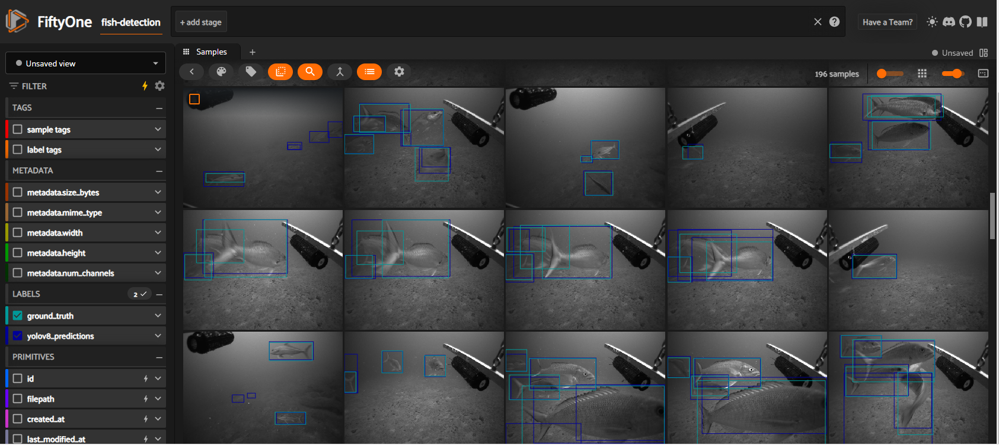

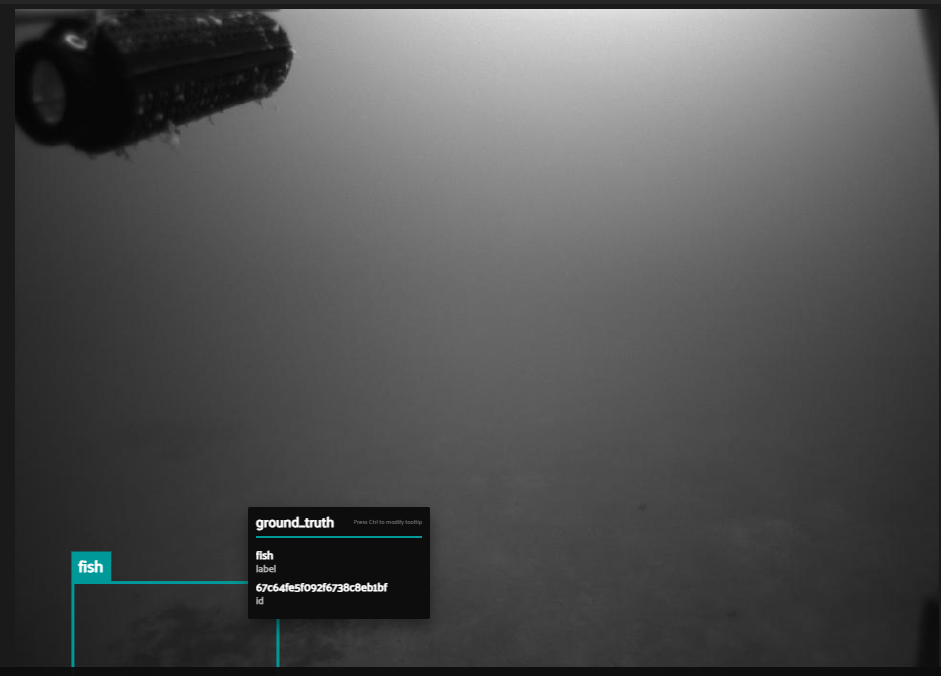